In [1]:
import graspologic

import matplotlib.pyplot as plt
import numpy as np
%matplotlib inline

# First simulation

We sample 2-block SBMs (undirected, no self-loops) with 50 vertices, each block containing 25 vertices (n = [25, 25]), and the following block probabilities:

\begin{align*}
P_1 = 
\begin{bmatrix}0.3 & 0.1\\
0.1 & 0.7
\end{bmatrix},~
P_2 = \begin{bmatrix}0.3 & 0.1\\
0.1 & 0.3
\end{bmatrix}
\end{align*}

The only difference between the two are the block probability for the second block. We sample $G_1 \sim \text{SBM}(n, P_1)$ and $G_2 \sim \text{SBM}(n, P_2)$.

In [2]:
from graspologic.simulations import sbm

m = 100
n = [m, m]
P1 = [[.3, .1], 
      [.1, .7]]
P2 = [[.3, .1], 
      [.1, .3]]

np.random.seed(8)
G1 = sbm(n, P1)
G2 = sbm(n, P2)

## Visualize the graphs using heatmap

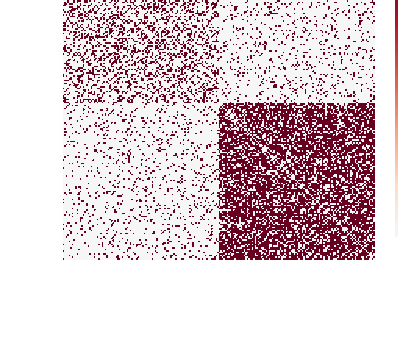

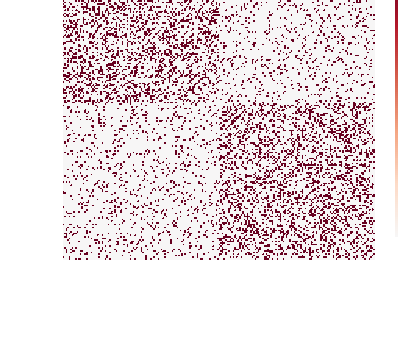

In [3]:
from graspologic.plot import heatmap

heatmap(G1, figsize=(7, 7), title='Visualization of Graph 1')
_ = heatmap(G2, figsize=(7, 7), title='Visualization of Graph 2')

## Embed the two graphs using omnibus embedding

The first embedding is regular OMNI and adjancency matrices 

The second embedding is OMNI with graph laplacians with the dimension set to 2

In [4]:
from graspologic.embed import OmnibusEmbed

embedder = OmnibusEmbed()
Zhat_ase = embedder.fit_transform([G1, G2])
print(Zhat_ase.shape)

embedder = OmnibusEmbed(diag_aug=False, lse=True)
Zhat_lse = embedder.fit_transform([G1, G2])
print(Zhat_lse.shape)

(2, 200, 2)
(2, 200, 6)


## Visualize the embedding

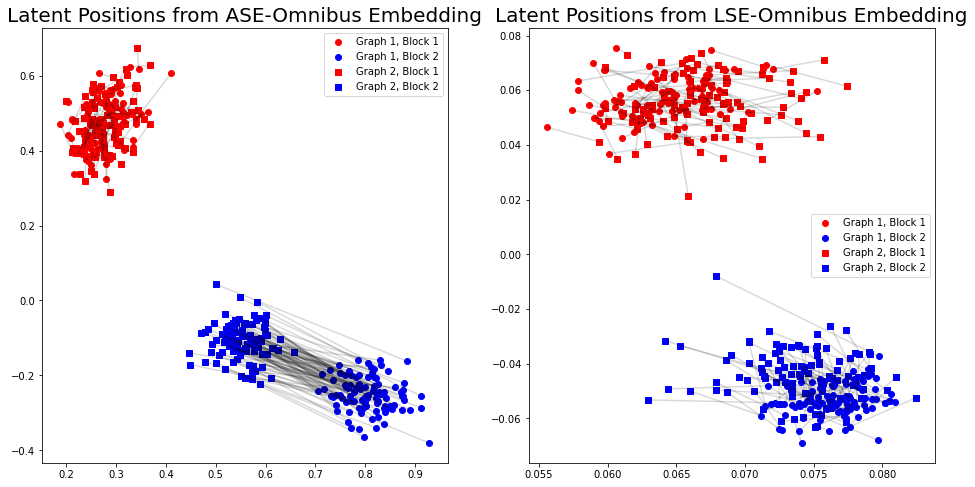

In [5]:
Xhat1 = Zhat_ase[0]
Xhat2 = Zhat_ase[1]

# Plot the points
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
ax1.scatter(Xhat1[:m, 0], Xhat1[:m, 1], marker='o', c='red', label = 'Graph 1, Block 1')
ax1.scatter(Xhat1[m:, 0], Xhat1[m:, 1], marker='o', c='blue', label = 'Graph 1, Block 2')
ax1.scatter(Xhat2[:m, 0], Xhat2[:m, 1], marker='s', c='red', label = 'Graph 2, Block 1')
ax1.scatter(Xhat2[m:, 0], Xhat2[m:, 1], marker='s', c='blue', label= 'Graph 2, Block 2')
ax1.legend()

# Plot lines between matched pairs of points
for i in range(2*m):
    ax1.plot([Xhat1[i, 0], Xhat2[i, 0]], [Xhat1[i, 1], Xhat2[i, 1]], 'black', alpha = 0.15)
    
_ = ax1.set_title('Latent Positions from ASE-Omnibus Embedding', fontsize=20)

Xhat1 = Zhat_lse[0]
Xhat2 = Zhat_lse[1]

# Plot the points
ax2.scatter(Xhat1[:m, 0], Xhat1[:m, 1], marker='o', c='red', label = 'Graph 1, Block 1')
ax2.scatter(Xhat1[m:, 0], Xhat1[m:, 1], marker='o', c='blue', label = 'Graph 1, Block 2')
ax2.scatter(Xhat2[:m, 0], Xhat2[:m, 1], marker='s', c='red', label = 'Graph 2, Block 1')
ax2.scatter(Xhat2[m:, 0], Xhat2[m:, 1], marker='s', c='blue', label= 'Graph 2, Block 2')
ax2.legend()

# Plot lines between matched pairs of points
for i in range(2*m):
    ax2.plot([Xhat1[i, 0], Xhat2[i, 0]], [Xhat1[i, 1], Xhat2[i, 1]], 'black', alpha = 0.15)
    
_ = ax2.set_title('Latent Positions from LSE-Omnibus Embedding', fontsize=20)

## Pairplot of ASE-OMNI

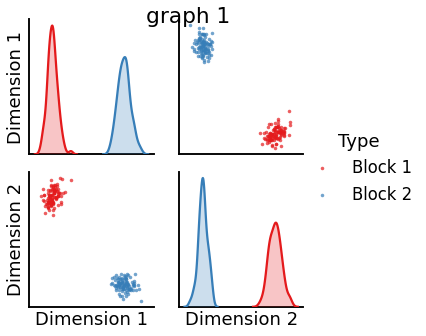

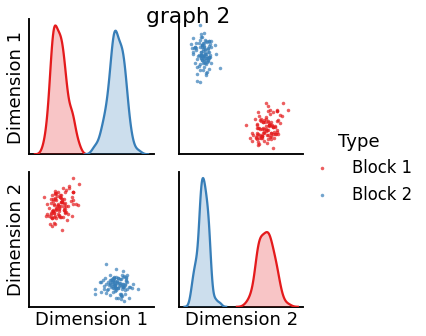

In [6]:
from graspologic.plot import pairplot

Xhat1 = Zhat_ase[0]
Xhat2 = Zhat_ase[1]
labels = ['Block 1'] * m + ['Block 2'] * m
_ = pairplot(Xhat1, labels, title='graph 1')
_ = pairplot(Xhat2, labels, title='graph 2')

## Pairplot of separate ASE

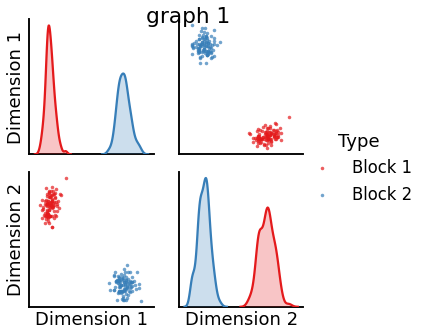

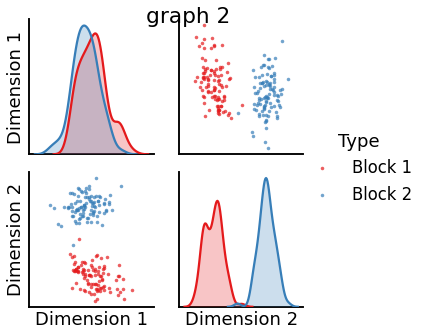

In [7]:
from graspologic.embed import AdjacencySpectralEmbed

ase = AdjacencySpectralEmbed()
Xhat1 = ase.fit_transform(G1)
Xhat2 = ase.fit_transform(G2)
_ = pairplot(Xhat1, labels, title='graph 1')
_ = pairplot(Xhat2, labels, title='graph 2')

## Pairplot of LSE-OMNI

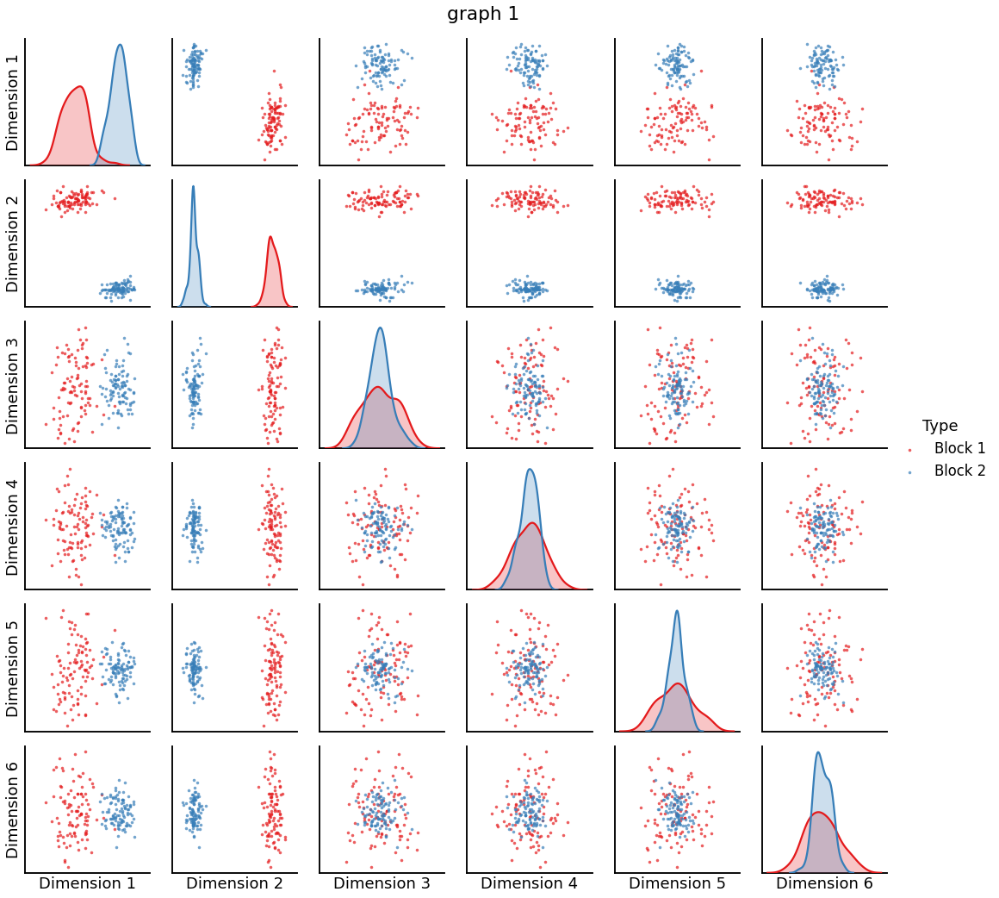

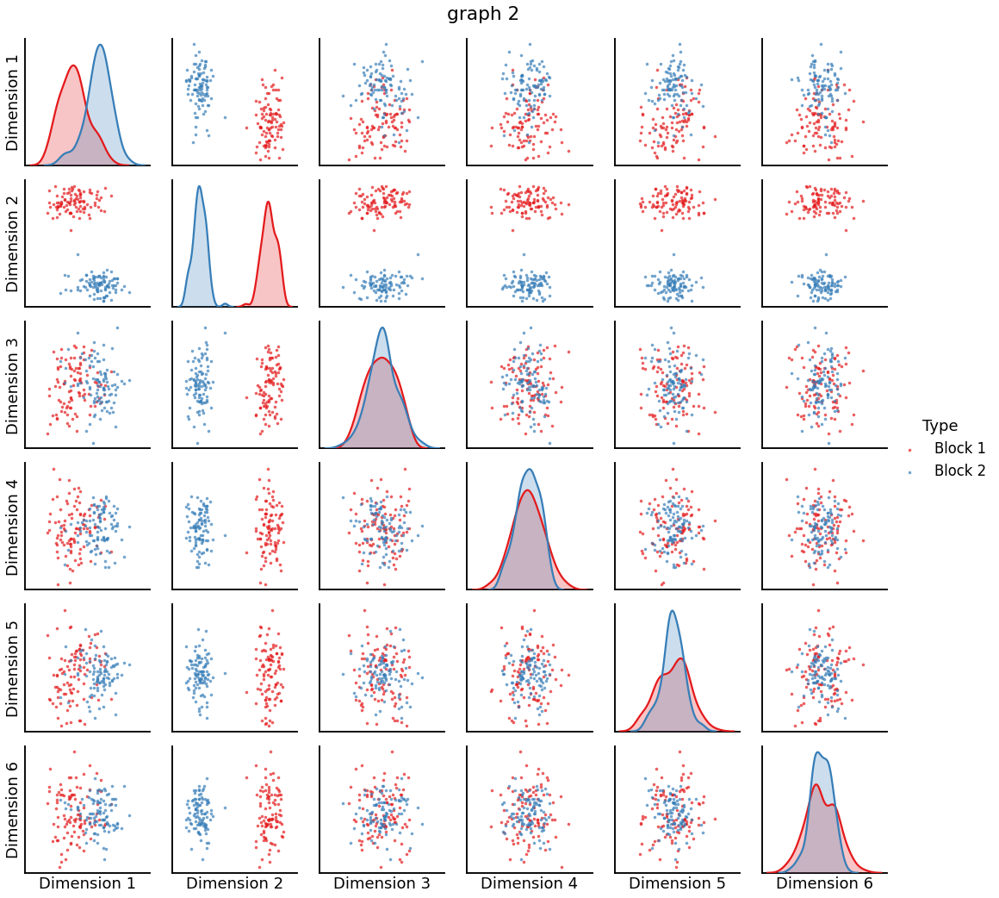

In [8]:
Xhat1 = Zhat_lse[0]
Xhat2 = Zhat_lse[1]

_ = pairplot(Xhat1, labels, title='graph 1')
_ = pairplot(Xhat2, labels, title='graph 2')

## Pairplot of separate LSE

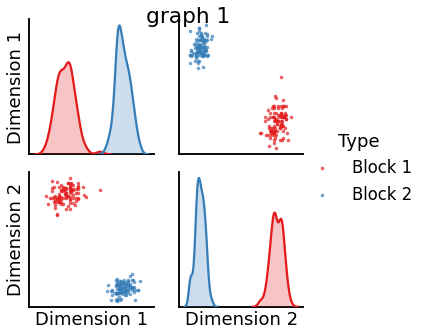

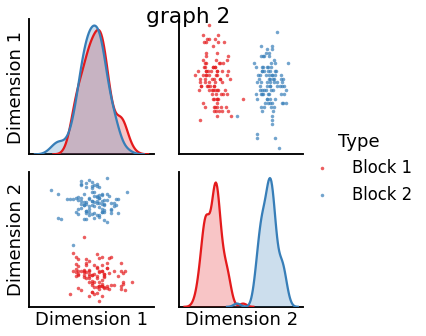

In [9]:
from graspologic.embed import LaplacianSpectralEmbed

lse = LaplacianSpectralEmbed(n_components=2)
Xhat1 = lse.fit_transform(G1)
Xhat2 = lse.fit_transform(G2)
_ = pairplot(Xhat1, labels, title='graph 1')
_ = pairplot(Xhat2, labels, title='graph 2')

# Second simulation

If we increase the difference between the connectivities of block 2 of the two graphs, we should be able to see larger distance between the block 2 of the two graphs in the embedding.

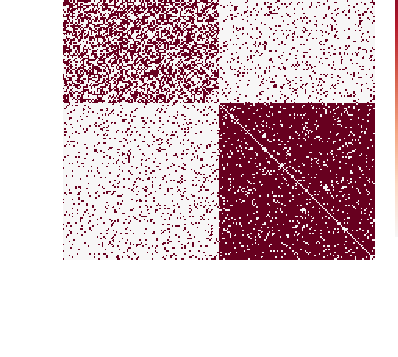

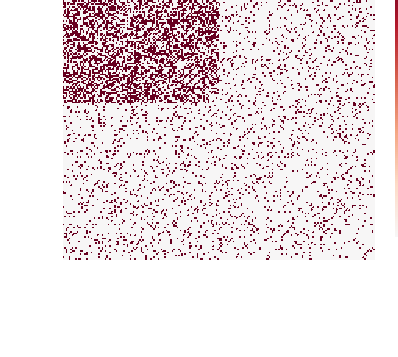

In [16]:
from graspologic.simulations import sbm

n = [m, m]
P1 = [[.5, .1], 
      [.1, .9]]
P2 = [[.5, .1], 
      [.1, .1]]

np.random.seed(8)
G1 = sbm(n, P1)
G2 = sbm(n, P2)
heatmap(G1, figsize=(7, 7), title='Visualization of Graph 1')
_ = heatmap(G2, figsize=(7, 7), title='Visualization of Graph 2')

## The original embedding

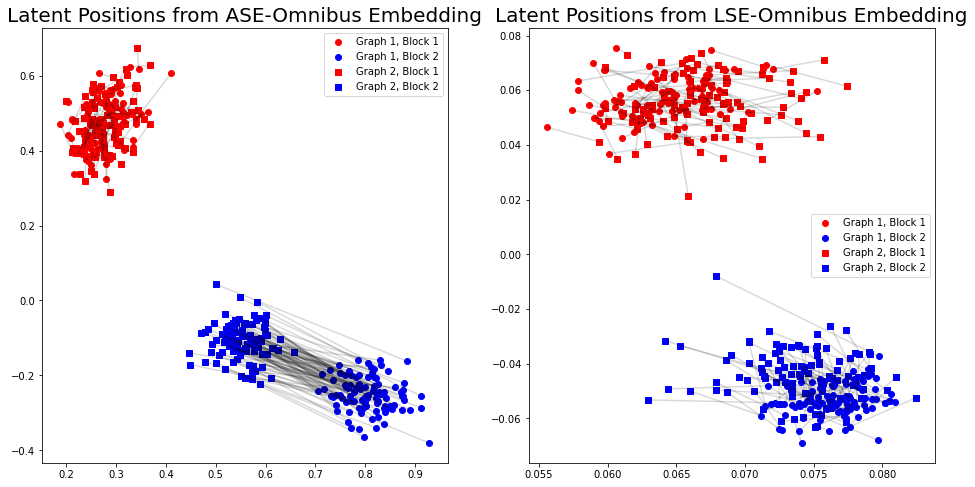

In [11]:
Xhat1 = Zhat_ase[0]
Xhat2 = Zhat_ase[1]

# Plot the points
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
ax1.scatter(Xhat1[:m, 0], Xhat1[:m, 1], marker='o', c='red', label = 'Graph 1, Block 1')
ax1.scatter(Xhat1[m:, 0], Xhat1[m:, 1], marker='o', c='blue', label = 'Graph 1, Block 2')
ax1.scatter(Xhat2[:m, 0], Xhat2[:m, 1], marker='s', c='red', label = 'Graph 2, Block 1')
ax1.scatter(Xhat2[m:, 0], Xhat2[m:, 1], marker='s', c='blue', label= 'Graph 2, Block 2')
ax1.legend()

# Plot lines between matched pairs of points
for i in range(2*m):
    ax1.plot([Xhat1[i, 0], Xhat2[i, 0]], [Xhat1[i, 1], Xhat2[i, 1]], 'black', alpha = 0.15)
    
_ = ax1.set_title('Latent Positions from ASE-Omnibus Embedding', fontsize=20)

Xhat1 = Zhat_lse[0]
Xhat2 = Zhat_lse[1]

# Plot the points
ax2.scatter(Xhat1[:m, 0], Xhat1[:m, 1], marker='o', c='red', label = 'Graph 1, Block 1')
ax2.scatter(Xhat1[m:, 0], Xhat1[m:, 1], marker='o', c='blue', label = 'Graph 1, Block 2')
ax2.scatter(Xhat2[:m, 0], Xhat2[:m, 1], marker='s', c='red', label = 'Graph 2, Block 1')
ax2.scatter(Xhat2[m:, 0], Xhat2[m:, 1], marker='s', c='blue', label= 'Graph 2, Block 2')
ax2.legend()

# Plot lines between matched pairs of points
for i in range(2*m):
    ax2.plot([Xhat1[i, 0], Xhat2[i, 0]], [Xhat1[i, 1], Xhat2[i, 1]], 'black', alpha = 0.15)
    
_ = ax2.set_title('Latent Positions from LSE-Omnibus Embedding', fontsize=20)

In [17]:
embedder = OmnibusEmbed()
Zhat_ase = embedder.fit_transform([G1, G2])
print(Zhat_ase.shape)

embedder = OmnibusEmbed(diag_aug=False, lse=True)
Zhat_lse = embedder.fit_transform([G1, G2])
print(Zhat_lse.shape)

(2, 200, 4)
(2, 200, 6)


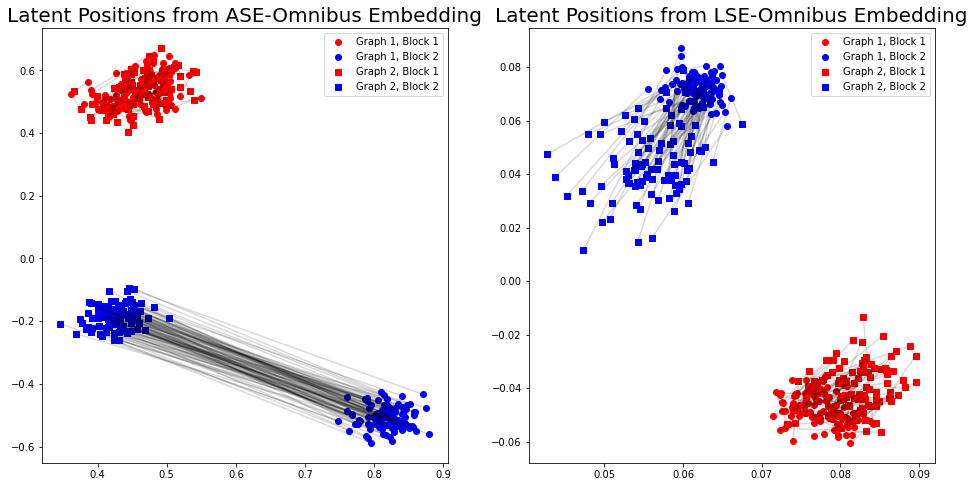

In [18]:
Xhat1 = Zhat_ase[0]
Xhat2 = Zhat_ase[1]

# Plot the points
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 8))
ax1.scatter(Xhat1[:m, 0], Xhat1[:m, 1], marker='o', c='red', label = 'Graph 1, Block 1')
ax1.scatter(Xhat1[m:, 0], Xhat1[m:, 1], marker='o', c='blue', label = 'Graph 1, Block 2')
ax1.scatter(Xhat2[:m, 0], Xhat2[:m, 1], marker='s', c='red', label = 'Graph 2, Block 1')
ax1.scatter(Xhat2[m:, 0], Xhat2[m:, 1], marker='s', c='blue', label= 'Graph 2, Block 2')
ax1.legend()

# Plot lines between matched pairs of points
for i in range(2*m):
    ax1.plot([Xhat1[i, 0], Xhat2[i, 0]], [Xhat1[i, 1], Xhat2[i, 1]], 'black', alpha = 0.15)
    
_ = ax1.set_title('Latent Positions from ASE-Omnibus Embedding', fontsize=20)

Xhat1 = Zhat_lse[0]
Xhat2 = Zhat_lse[1]

# Plot the points
ax2.scatter(Xhat1[:m, 0], Xhat1[:m, 1], marker='o', c='red', label = 'Graph 1, Block 1')
ax2.scatter(Xhat1[m:, 0], Xhat1[m:, 1], marker='o', c='blue', label = 'Graph 1, Block 2')
ax2.scatter(Xhat2[:m, 0], Xhat2[:m, 1], marker='s', c='red', label = 'Graph 2, Block 1')
ax2.scatter(Xhat2[m:, 0], Xhat2[m:, 1], marker='s', c='blue', label= 'Graph 2, Block 2')
ax2.legend()

# Plot lines between matched pairs of points
for i in range(2*m):
    ax2.plot([Xhat1[i, 0], Xhat2[i, 0]], [Xhat1[i, 1], Xhat2[i, 1]], 'black', alpha = 0.15)
    
_ = ax2.set_title('Latent Positions from LSE-Omnibus Embedding', fontsize=20)

## Pairplot of ASE-OMNI

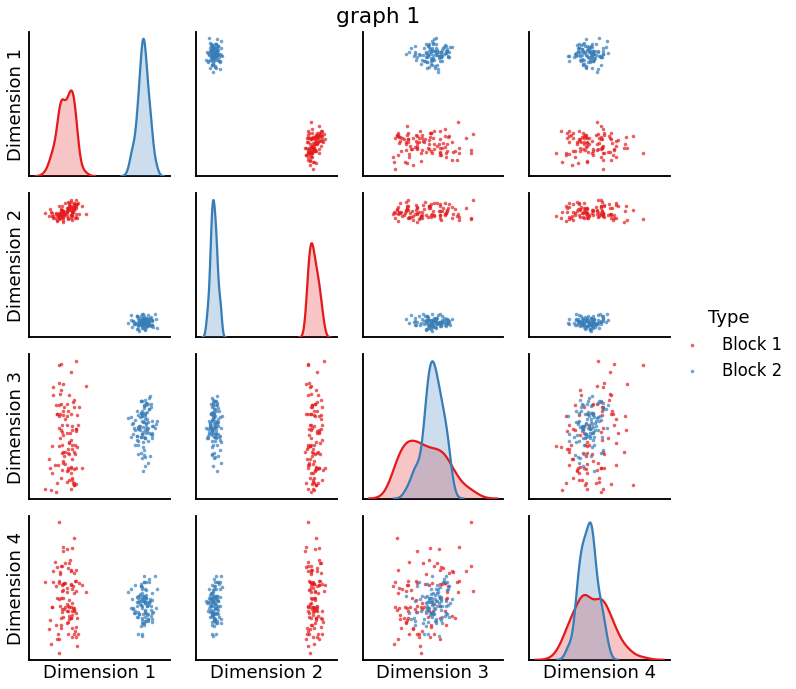

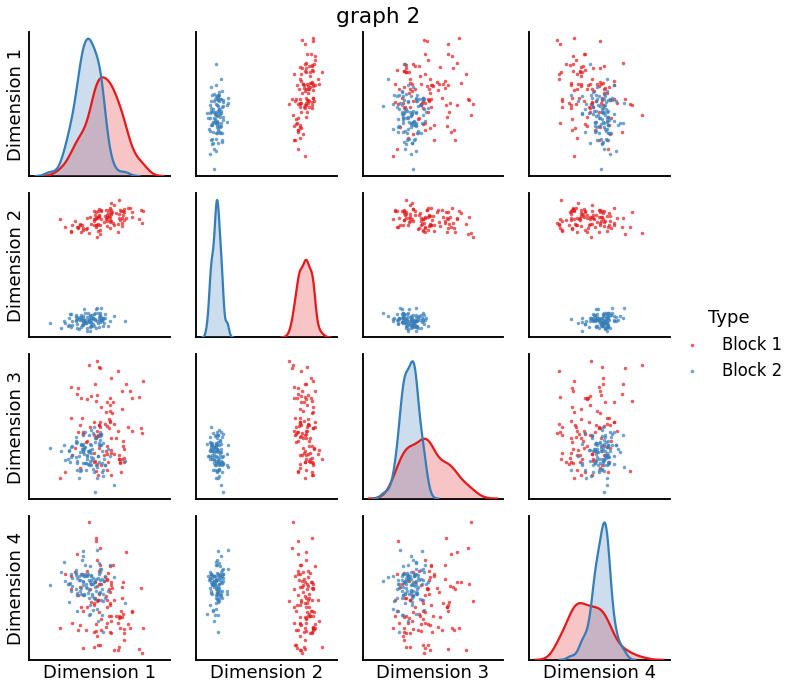

In [19]:
from graspologic.plot import pairplot

Xhat1 = Zhat_ase[0]
Xhat2 = Zhat_ase[1]
labels = ['Block 1'] * m + ['Block 2'] * m
_ = pairplot(Xhat1, labels, title='graph 1')
_ = pairplot(Xhat2, labels, title='graph 2')

## Pairplot of LSE-OMNI

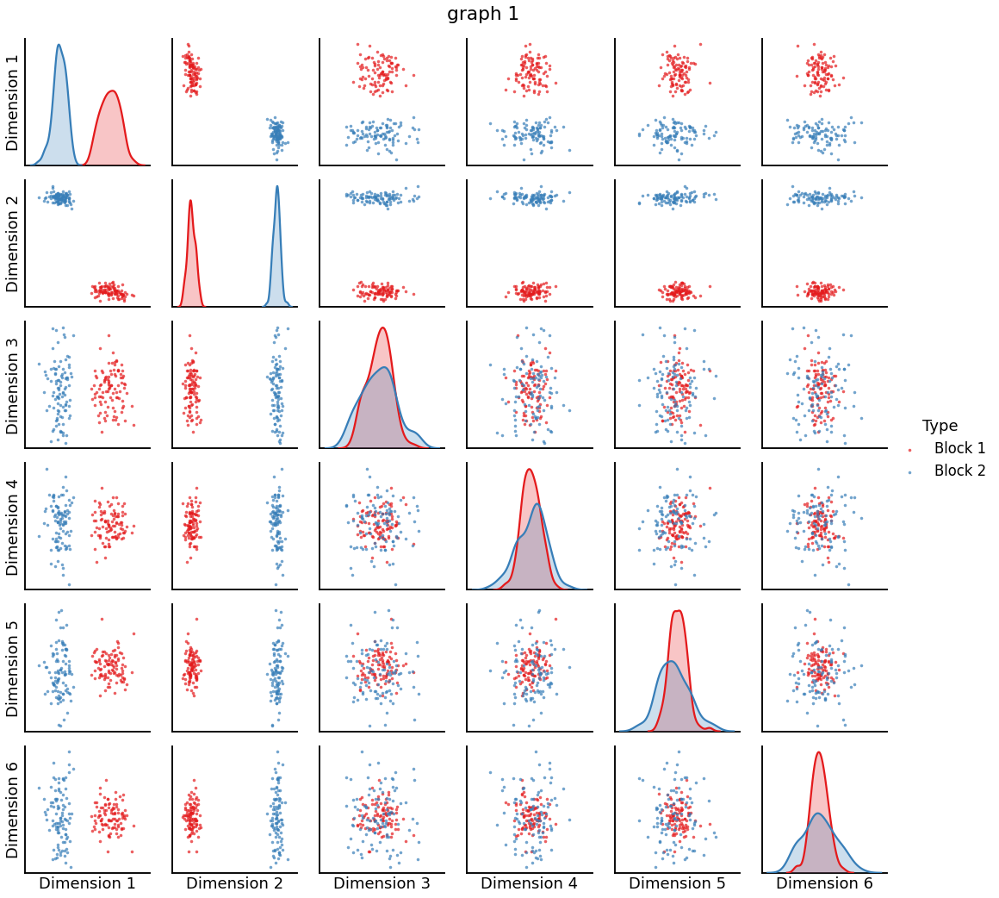

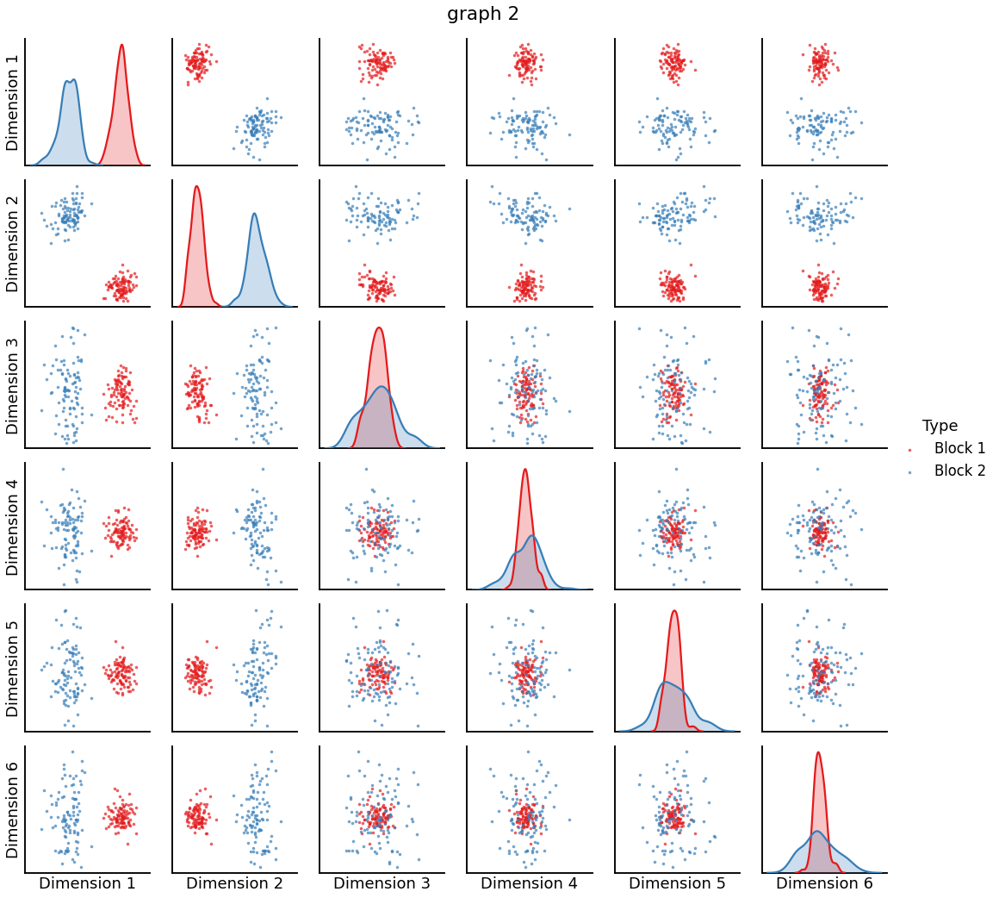

In [20]:
Xhat1 = Zhat_lse[0]
Xhat2 = Zhat_lse[1]

_ = pairplot(Xhat1, labels, title='graph 1')
_ = pairplot(Xhat2, labels, title='graph 2')